In [2]:
from IPython.display import display, HTML, Image
display(HTML("<style>.container { width:95% !important; }</style>"))

%load_ext autoreload
%autoreload 2

import os
import numpy as np
import pandas as pd
import scanpy as sc
import scanpy.external as sce
import json

from matplotlib import cm
import matplotlib.pyplot as plt

import sys
sys.path.append("../../lib")
from stpalette import palette_WM4007_rna, palette_WM4237_rna
from plots import plotSpatialAll
from sankey import getCountsDataframe, makeSankeyDiagram
from utils import loadAdImage
import scipy.spatial.distance

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [3]:
model = 'WM4007'
palette_rna = palette_WM4007_rna if model=='WM4007' else palette_WM4237_rna

In [4]:
ncols = 6

In [5]:
preprocessedStDataPath = 'd:/from HPCC 11 28 2022/results_NF1-nod-t2t-k35/%s/' % model
preprocessedImStDataPath = 'd:/from HPCC 11 28 2022/results_NF2/%s_ST/' % model
preprocessedImAdDataPath = 'd:/from HPCC 11 28 2022/results_NF2/%s_3_AD_m/' % model

dataPath = '../../data/'

ids = sorted(np.loadtxt(dataPath + 'ids_%s_ST.txt' % model, dtype=str))
ids = [id for id in ids if not '_TE_' in id]
print(ids)

ids_ad = sorted(np.loadtxt(dataPath + 'ids_%s_AD.txt' % model, dtype=str))
ids_ad = [id for id in ids_ad if not '_TE_' in id]
print(ids_ad)

['WM4007_T0_S1_ST', 'WM4007_T0_S2_ST', 'WM4007_T1_S1_ST', 'WM4007_T1_S2_ST', 'WM4007_T2_S1_ST', 'WM4007_T2_S2_ST', 'WM4007_T3_S1_ST', 'WM4007_T3_S2_ST', 'WM4007_T4_S1_ST', 'WM4007_T4_S2_ST', 'WM4007_TC_S1_ST', 'WM4007_TC_S2_ST']
['WM4007_T0_S1_AD', 'WM4007_T0_S2_AD', 'WM4007_T1_S1_AD', 'WM4007_T1_S2_AD', 'WM4007_T2_S1_AD', 'WM4007_T2_S2_AD', 'WM4007_T3_S1_AD', 'WM4007_T3_S2_AD', 'WM4007_T4_S1_AD', 'WM4007_T4_S2_AD', 'WM4007_TC_S1_AD', 'WM4007_TC_S2_AD']


### AD

##### Load imaging data

In [6]:
ads = dict()
for sample in ids_ad:
    df_temp = pd.read_csv(preprocessedImAdDataPath + '%s/data.csv.gz' % sample, index_col=[0,1]).xs(1, level='in_tissue')
    df_temp.insert(0, 'original_barcode', df_temp.index.values)
    ads.update({sample: sc.AnnData(X=df_temp.loc[:, df_temp.columns.str.contains('feat')],
                                   obs=df_temp.loc[:, ~df_temp.columns.str.contains('feat')])})
    
ad_im_ad_all = sc.concat(ads, label='sample', join='outer', index_unique ='-')
ad_im_ad_all

AnnData object with n_obs × n_vars = 16479 × 2048
    obs: 'original_barcode', 'array_row', 'array_col', 'pxl_row_in_fullres', 'pxl_col_in_fullres', 'pxl_row_in_wsi', 'pxl_col_in_wsi', 'density_connective', 'density_inflammatory', 'density_necrosis', 'density_neoplasia', 'density_no_label', 'density_no_neoplasia', 'count_connective', 'count_inflammatory', 'count_necrosis', 'count_neoplasia', 'count_no_label', 'count_no_neoplasia', 'total_count', 'average_perimeter_length_connective', 'average_perimeter_length_inflammatory', 'average_perimeter_length_necrosis', 'average_perimeter_length_neoplasia', 'average_perimeter_length_no_label', 'average_perimeter_length_no_neoplasia', 'std_perimeter_length_connective', 'std_perimeter_length_inflammatory', 'std_perimeter_length_necrosis', 'std_perimeter_length_neoplasia', 'std_perimeter_length_no_label', 'std_perimeter_length_no_neoplasia', 'average_perimeter_length', 'std_perimeter_length', 'average_area_connective', 'average_area_inflammatory', 

##### Inception features UMAP and clustering

In [6]:
sc.pp.highly_variable_genes(ad_im_ad_all, flavor='seurat', batch_key='sample', n_top_genes=250)
print(ad_im_ad_all.var['highly_variable'].sum())
sc.pp.pca(ad_im_ad_all, n_comps=30, zero_center=True, use_highly_variable=True)

if True:
    sce.pp.harmony_integrate(ad_im_ad_all, 'sample', lamb=1.0)
    sc.pp.neighbors(ad_im_ad_all, use_rep='X_pca_harmony')
    sc.tl.umap(ad_im_ad_all)
    sc.tl.leiden(ad_im_ad_all, key_added='cluster_harmonized', resolution=0.75)
    
if True:
    sc.pp.neighbors(ad_im_ad_all, use_rep='X_pca')
    sc.tl.umap(ad_im_ad_all)
    sc.tl.leiden(ad_im_ad_all, key_added='cluster', resolution=0.75)

250


2023-06-05 10:09:25,784 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2023-06-05 10:09:32,730 - harmonypy - INFO - sklearn.KMeans initialization complete.
2023-06-05 10:09:32,895 - harmonypy - INFO - Iteration 1 of 10
2023-06-05 10:09:42,493 - harmonypy - INFO - Iteration 2 of 10
2023-06-05 10:09:52,231 - harmonypy - INFO - Iteration 3 of 10
2023-06-05 10:10:02,099 - harmonypy - INFO - Converged after 3 iterations


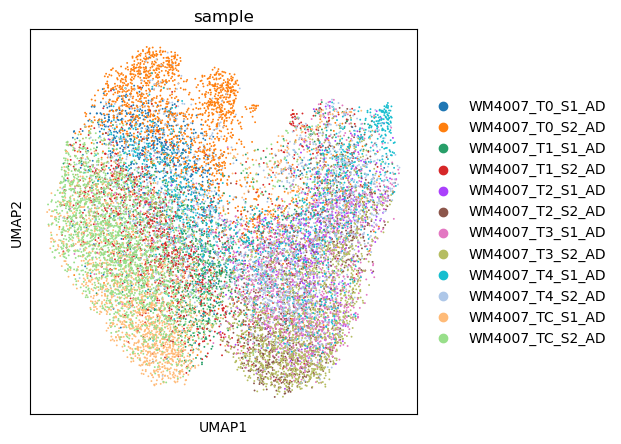

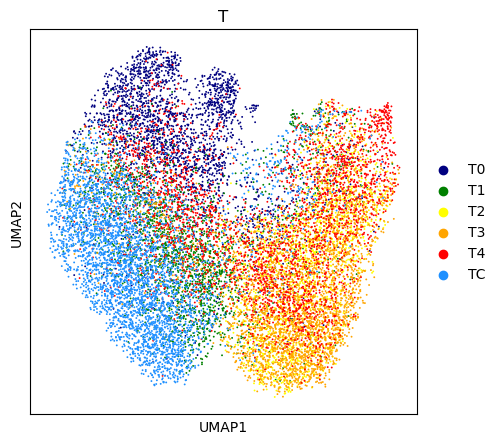

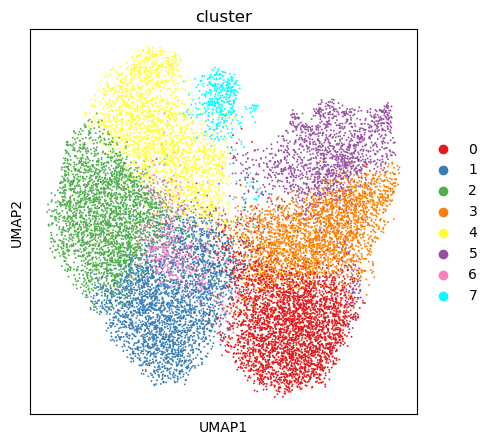

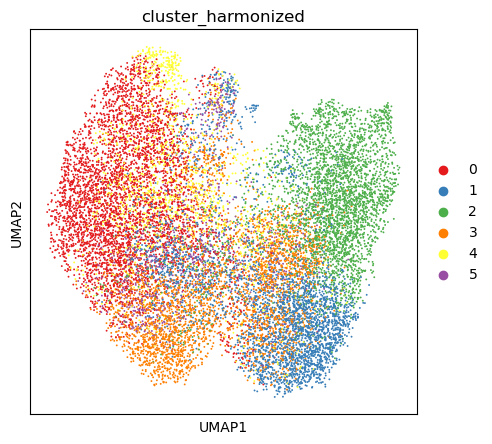

In [7]:
plt.rcParams["figure.figsize"] = (5,5)
sc.pl.umap(ad_im_ad_all, color=['sample'])

ad_im_ad_all.obs['T'] = ad_im_ad_all.obs['sample'].str.split('_', expand=True)[1]
sc.pl.umap(ad_im_ad_all, color=['T'], palette=palette_rna)

sc.pl.umap(ad_im_ad_all, color=['cluster'], palette=palette_rna)
sc.pl.umap(ad_im_ad_all, color=['cluster_harmonized'], palette=palette_rna)

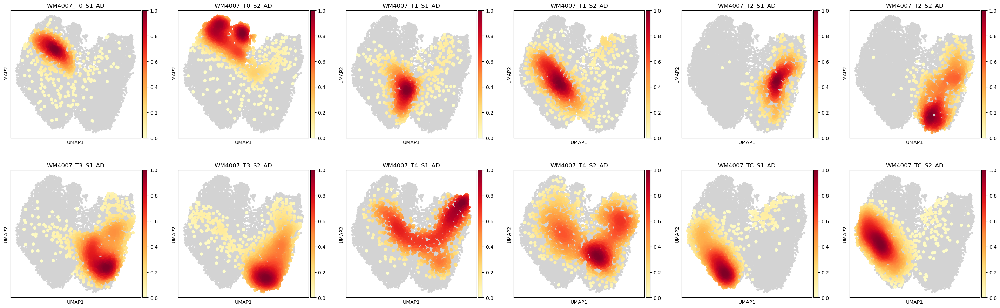

In [8]:
identity = 'sample'
sc.tl.embedding_density(ad_im_ad_all, basis='umap', groupby=identity)
sc.pl.embedding_density(ad_im_ad_all, groupby=identity, ncols=ncols)

##### Load AD images and tile coordinates

In [7]:
images = {sample: loadAdImage(preprocessedImAdDataPath + sample) for sample in ids_ad}

ad_im_ad_all.obs['count_connective'] = ad_im_ad_all.obs['count_connective'].fillna(0).astype(int)
ad_im_ad_all.obs['count_neoplasia'] = ad_im_ad_all.obs['count_neoplasia'].fillna(0).astype(int)

ads_ad = dict()
for sample in ids_ad[:]:
    ads_ad[sample] = ad_im_ad_all[ad_im_ad_all.obs['sample']==sample, :].copy()    
    ads_ad[sample].uns['spatial'] = images[sample][0]
    ads_ad[sample].obsm['spatial'] = pd.DataFrame(index=images[sample][1], data=images[sample][2]).reindex(ads_ad[sample].obs['original_barcode']).values

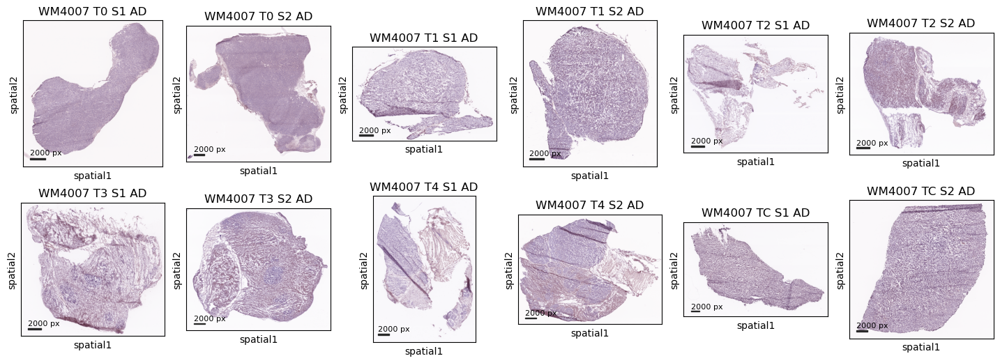

In [10]:
plotSpatialAll(ads_ad, nx=ncols, f=0.6)

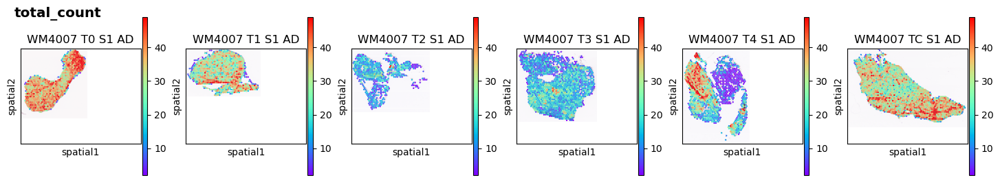

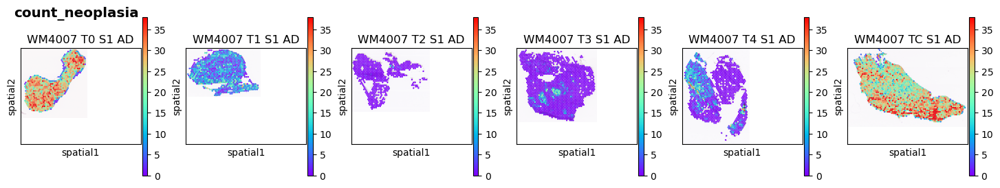

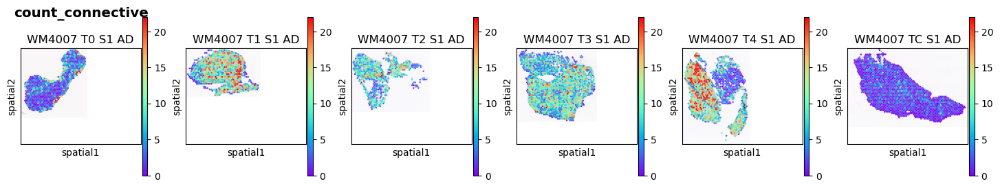

In [14]:
plotSpatialAll({id: ads_ad[id] for id in ids_ad if 'S1' in id}, identity='total_count', nx=ncols, maintainScale=True, f=0.6, wspace=0.25)
plotSpatialAll({id: ads_ad[id] for id in ids_ad if 'S1' in id}, identity='count_neoplasia', nx=ncols, maintainScale=True, f=0.6, wspace=0.25)
plotSpatialAll({id: ads_ad[id] for id in ids_ad if 'S1' in id}, identity='count_connective', nx=ncols, maintainScale=True, f=0.6, wspace=0.25)

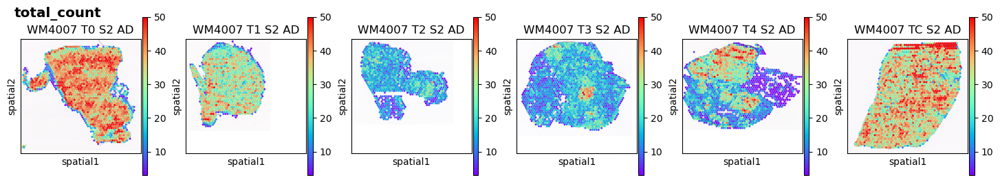

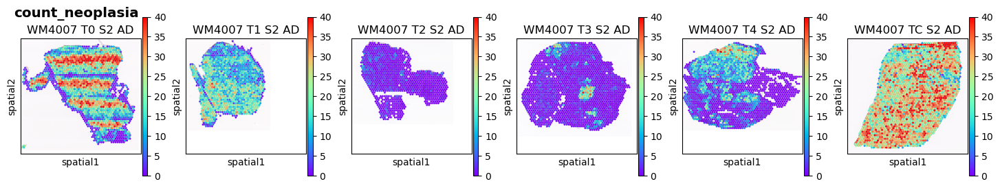

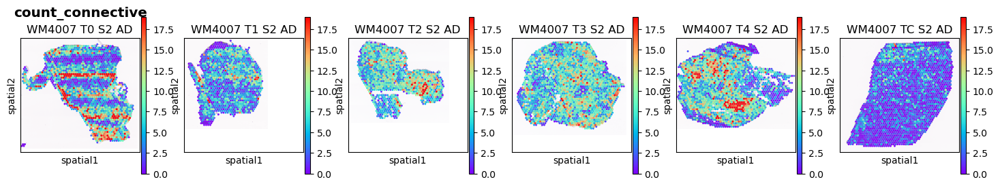

In [13]:
plotSpatialAll({id: ads_ad[id] for id in ids_ad if 'S2' in id}, identity='total_count', nx=ncols, maintainScale=True, f=0.6, wspace=0.25)
plotSpatialAll({id: ads_ad[id] for id in ids_ad if 'S2' in id}, identity='count_neoplasia', nx=ncols, maintainScale=True, f=0.6, wspace=0.25)
plotSpatialAll({id: ads_ad[id] for id in ids_ad if 'S2' in id}, identity='count_connective', nx=ncols, maintainScale=True, f=0.6, wspace=0.25)

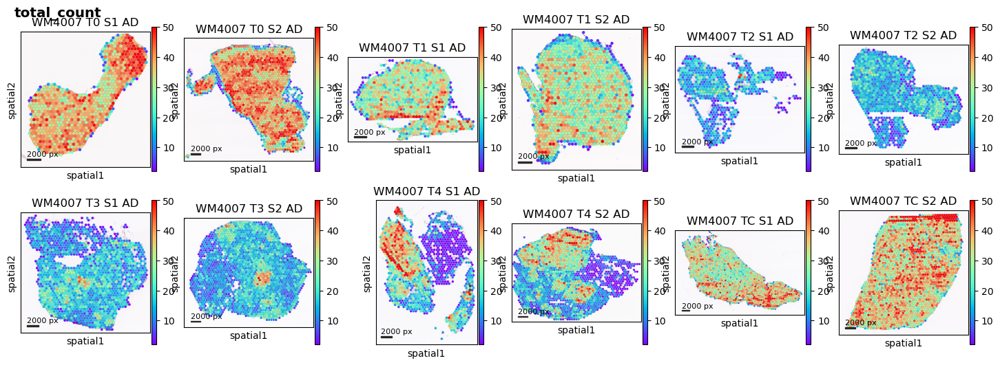

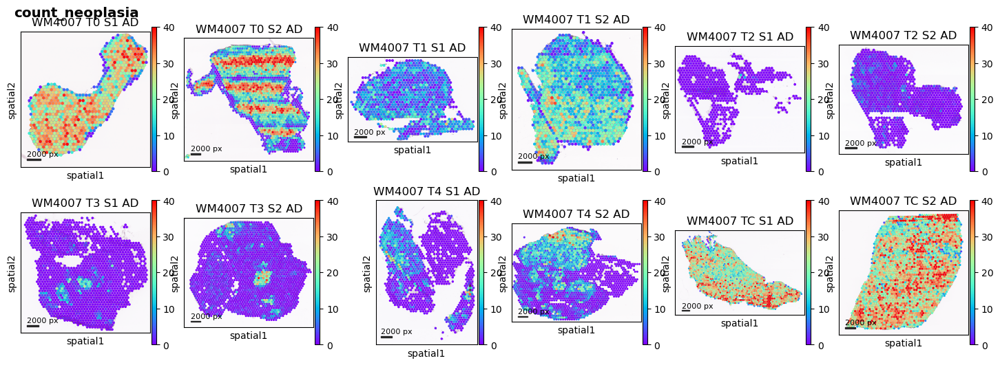

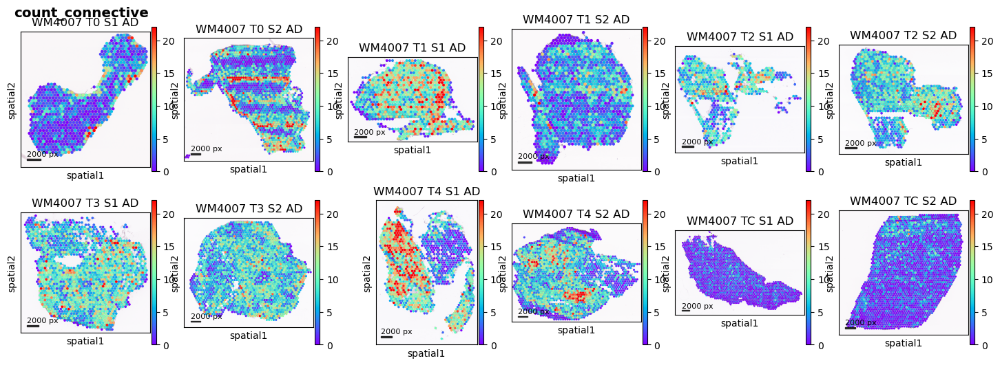

In [11]:
plotSpatialAll(ads_ad, identity='total_count', nx=ncols, maintainScale=False, f=0.6)
plotSpatialAll(ads_ad, identity='count_neoplasia', nx=ncols, f=0.6)
plotSpatialAll(ads_ad, identity='count_connective', nx=ncols, f=0.6)

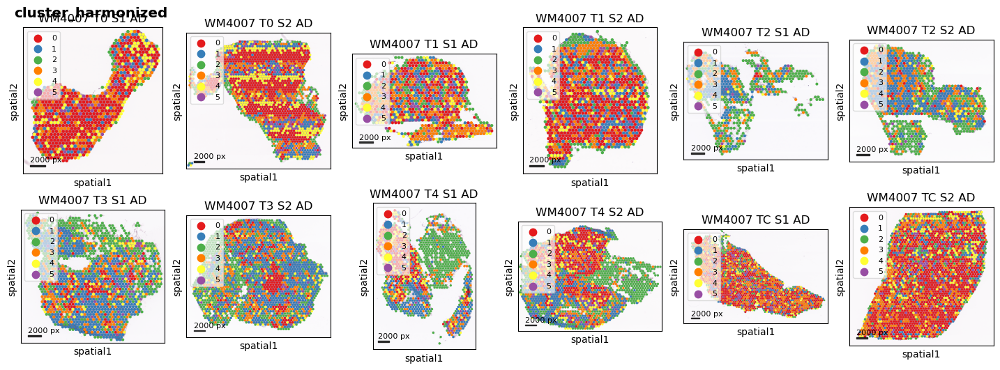

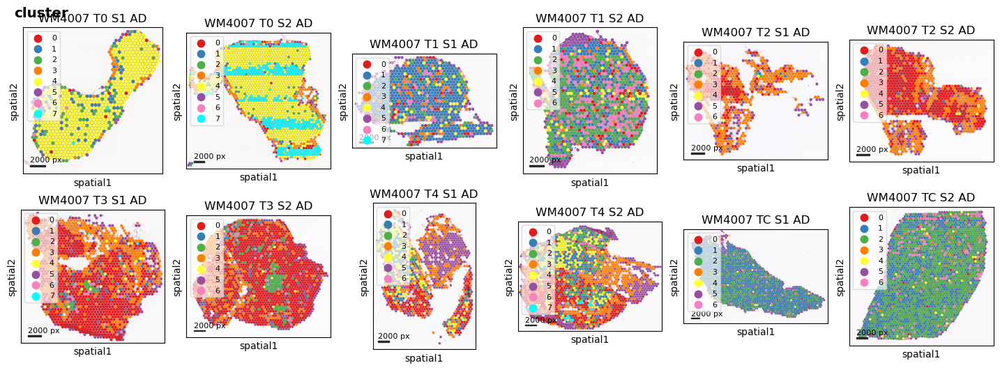

In [12]:
plotSpatialAll(ads_ad, identity='cluster_harmonized', nx=ncols, maintainScale=False, palette=palette_rna, f=0.6)
plotSpatialAll(ads_ad, identity='cluster', nx=ncols, maintainScale=False, palette=palette_rna, f=0.6)

###### Save AnnData object

In [13]:
ad_im_ad_all.write(dataPath + 'ad_all_human_clustered_im_ad_%s_m.h5ad' % model)

### ST

In [15]:
ads = dict()
for sample in ids:
    df_temp = pd.read_csv(preprocessedImStDataPath + '%s/data.csv.gz' % sample, index_col=[0,1]).xs(1, level='in_tissue')
    df_temp.insert(0, 'original_barcode', df_temp.index.values)
    ads.update({sample: sc.AnnData(X=df_temp.loc[:, df_temp.columns.str.contains('feat')],
                                   obs=df_temp.loc[:, ~df_temp.columns.str.contains('feat')])})
    
ad_im_all = sc.concat(ads, label='sample', join='outer', index_unique ='-')
ad_im_all

AnnData object with n_obs × n_vars = 18108 × 2048
    obs: 'original_barcode', 'array_row', 'array_col', 'pxl_row_in_fullres', 'pxl_col_in_fullres', 'pxl_row_in_wsi', 'pxl_col_in_wsi', 'density_connective', 'density_inflammatory', 'density_necrosis', 'density_neoplasia', 'density_no_label', 'density_no_neoplasia', 'count_connective', 'count_inflammatory', 'count_necrosis', 'count_neoplasia', 'count_no_label', 'count_no_neoplasia', 'total_count', 'average_perimeter_length_neoplasia', 'average_perimeter_length_no_label', 'average_perimeter_length_connective', 'average_perimeter_length_inflammatory', 'average_perimeter_length_no_neoplasia', 'average_perimeter_length_necrosis', 'average_perimeter_length', 'std_perimeter_length', 'average_area_neoplasia', 'average_area_no_label', 'average_area_connective', 'average_area_inflammatory', 'average_area_no_neoplasia', 'average_area_necrosis', 'average_area', 'std_area', 'average_orientation_neoplasia', 'average_orientation_no_label', 'average_or

In [15]:
sc.pp.highly_variable_genes(ad_im_all, flavor='seurat', batch_key='sample', n_top_genes=250)
print(ad_im_all.var['highly_variable'].sum())
sc.pp.pca(ad_im_all, n_comps=30, zero_center=True, use_highly_variable=True)

if True:
    sce.pp.harmony_integrate(ad_im_all, 'sample', lamb=1.0)
    sc.pp.neighbors(ad_im_all, use_rep='X_pca_harmony')
    sc.tl.umap(ad_im_all)
    sc.tl.leiden(ad_im_all, key_added='cluster_harmonized', resolution=0.75)
    
if True:
    sc.pp.neighbors(ad_im_all, use_rep='X_pca')
    sc.tl.umap(ad_im_all)
    sc.tl.leiden(ad_im_all, key_added='cluster', resolution=0.75)

250


2023-06-05 10:13:28,729 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2023-06-05 10:13:35,124 - harmonypy - INFO - sklearn.KMeans initialization complete.
2023-06-05 10:13:35,348 - harmonypy - INFO - Iteration 1 of 10
2023-06-05 10:13:46,845 - harmonypy - INFO - Iteration 2 of 10
2023-06-05 10:13:57,979 - harmonypy - INFO - Converged after 2 iterations


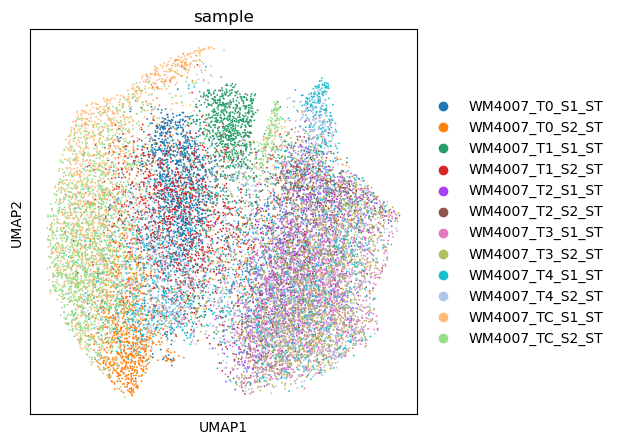

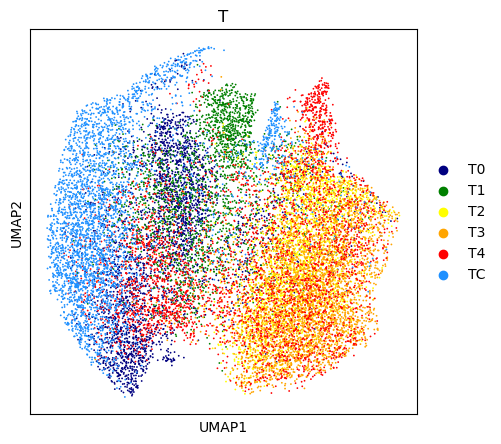

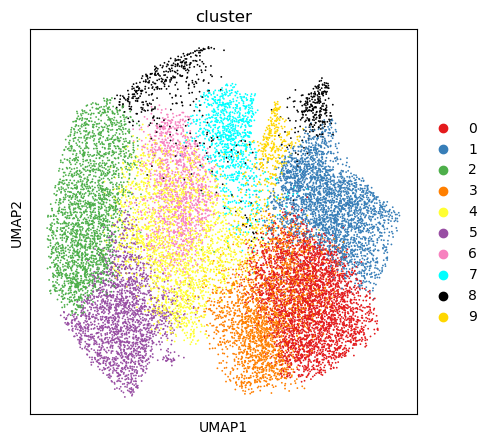

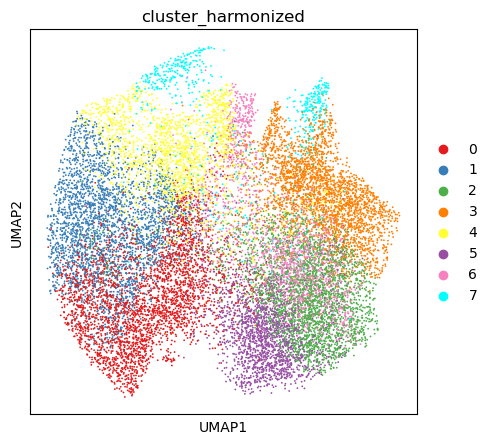

In [16]:
plt.rcParams["figure.figsize"] = (5,5)
sc.pl.umap(ad_im_all, color=['sample'])

ad_im_all.obs['T'] = ad_im_all.obs['sample'].str.split('_', expand=True)[1]
sc.pl.umap(ad_im_all, color=['T'], palette=palette_rna)

sc.pl.umap(ad_im_all, color=['cluster'], palette=palette_rna)
sc.pl.umap(ad_im_all, color=['cluster_harmonized'], palette=palette_rna)

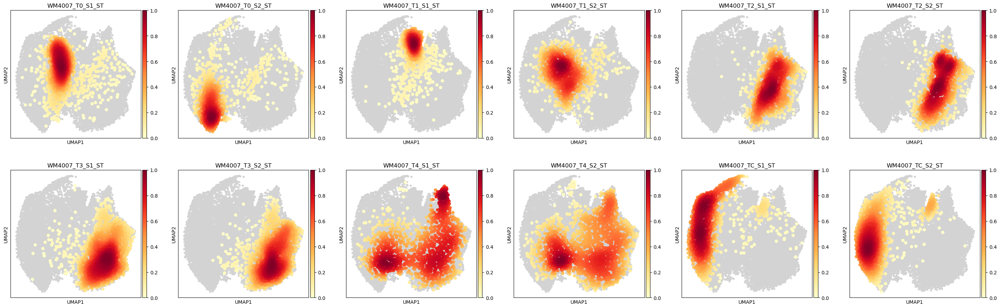

In [17]:
identity = 'sample'
sc.tl.embedding_density(ad_im_all, basis='umap', groupby=identity)
sc.pl.embedding_density(ad_im_all, groupby=identity, ncols=ncols)

In [16]:
images = {id: [(ad_temp := sc.read(preprocessedStDataPath + '%s/st_adata_processed.h5ad' % id)).uns['spatial'], ad_temp.obs.index, ad_temp.obsm['spatial']] for id in ids}

ad_im_all.obs['count_connective'] = ad_im_all.obs['count_connective'].fillna(0).astype(int)
ad_im_all.obs['count_neoplasia'] = ad_im_all.obs['count_neoplasia'].fillna(0).astype(int)

ads = dict()
for sample in ids[:]:
    ads[sample] = ad_im_all[ad_im_all.obs['sample']==sample, :].copy()    
    ads[sample].uns['spatial'] = images[sample][0]
    ads[sample].obsm['spatial'] = pd.DataFrame(index=images[sample][1], data=images[sample][2]).reindex(ads[sample].obs['original_barcode']).values

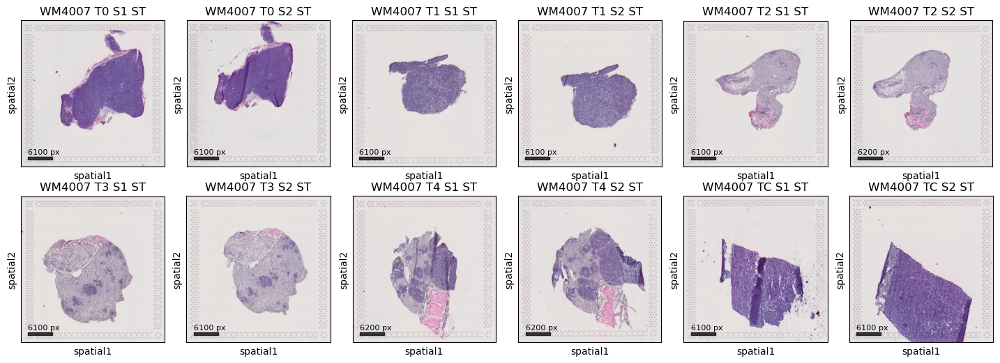

In [19]:
plotSpatialAll(ads, nx=ncols, f=0.6)

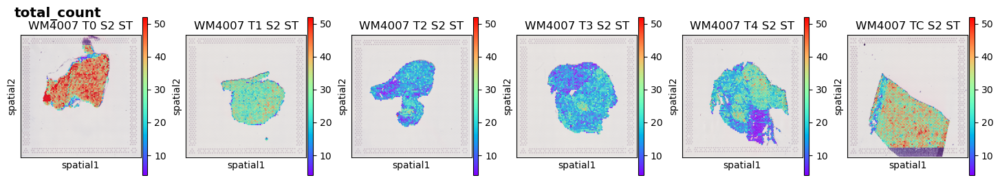

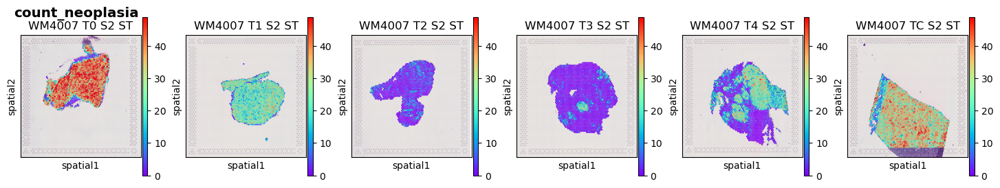

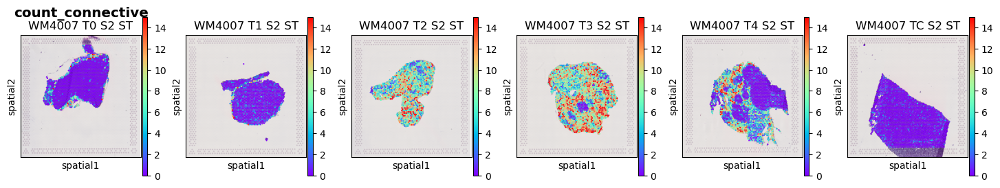

In [17]:
plotSpatialAll({id: ads[id] for id in ids if 'S2' in id}, identity='total_count', nx=ncols, maintainScale=True, f=0.6, wspace=0.25)
plotSpatialAll({id: ads[id] for id in ids if 'S2' in id}, identity='count_neoplasia', nx=ncols, maintainScale=True, f=0.6, wspace=0.25)
plotSpatialAll({id: ads[id] for id in ids if 'S2' in id}, identity='count_connective', nx=ncols, maintainScale=True, f=0.6, wspace=0.25)

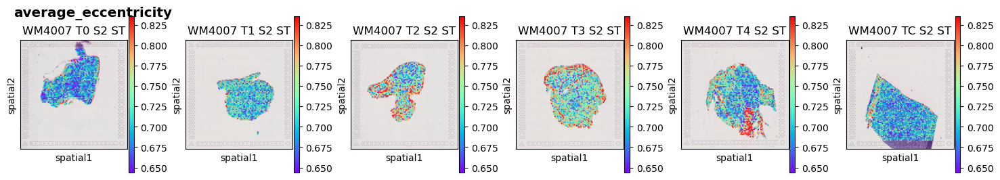

In [24]:
plotSpatialAll({id: ads[id] for id in ids if 'S2' in id}, identity='average_eccentricity', nx=ncols, maintainScale=True, f=0.6, wspace=0.4)

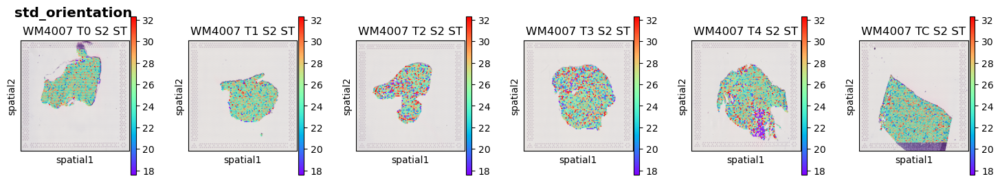

In [28]:
plotSpatialAll({id: ads[id] for id in ids if 'S2' in id}, identity='std_orientation', nx=ncols, maintainScale=True, f=0.6, wspace=0.4)

In [25]:
ad_im_ad_all.obs.columns

Index(['original_barcode', 'array_row', 'array_col', 'pxl_row_in_fullres',
       'pxl_col_in_fullres', 'pxl_row_in_wsi', 'pxl_col_in_wsi',
       'density_connective', 'density_inflammatory', 'density_necrosis',
       'density_neoplasia', 'density_no_label', 'density_no_neoplasia',
       'count_connective', 'count_inflammatory', 'count_necrosis',
       'count_neoplasia', 'count_no_label', 'count_no_neoplasia',
       'total_count', 'average_perimeter_length_connective',
       'average_perimeter_length_inflammatory',
       'average_perimeter_length_necrosis',
       'average_perimeter_length_neoplasia',
       'average_perimeter_length_no_label',
       'average_perimeter_length_no_neoplasia',
       'std_perimeter_length_connective', 'std_perimeter_length_inflammatory',
       'std_perimeter_length_necrosis', 'std_perimeter_length_neoplasia',
       'std_perimeter_length_no_label', 'std_perimeter_length_no_neoplasia',
       'average_perimeter_length', 'std_perimeter_length',
   

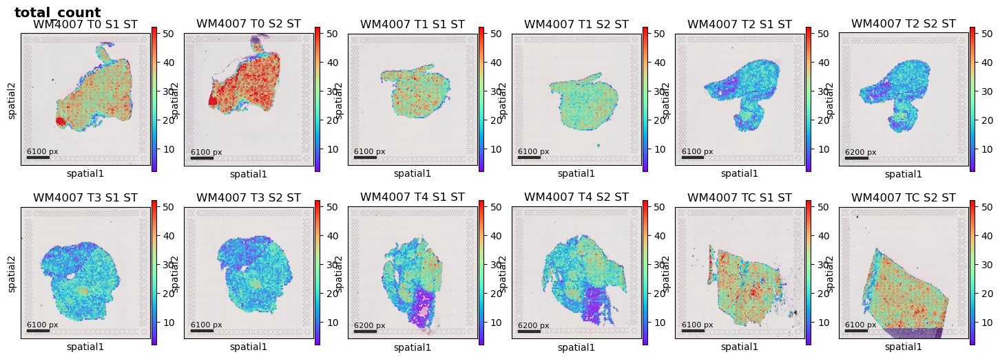

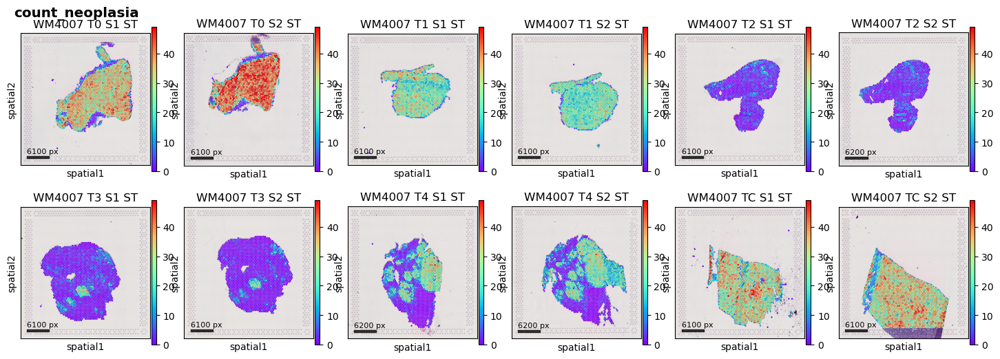

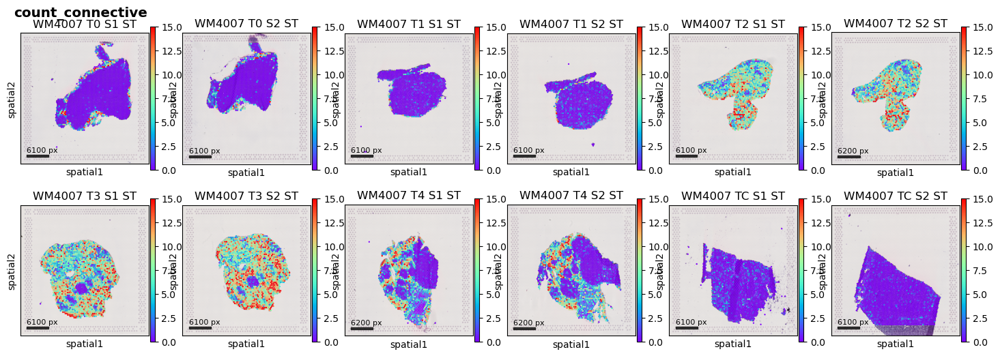

In [20]:
plotSpatialAll(ads, identity='total_count', nx=ncols, maintainScale=False, f=0.6)
plotSpatialAll(ads, identity='count_neoplasia', nx=ncols, f=0.6)
plotSpatialAll(ads, identity='count_connective', nx=ncols, f=0.6)

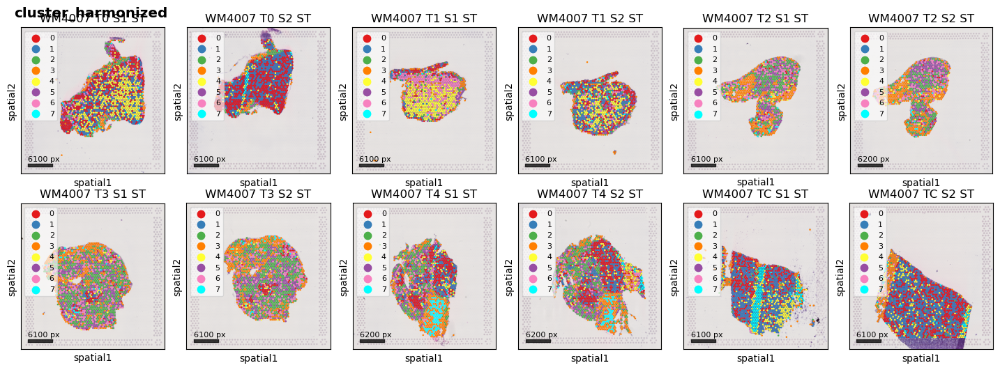

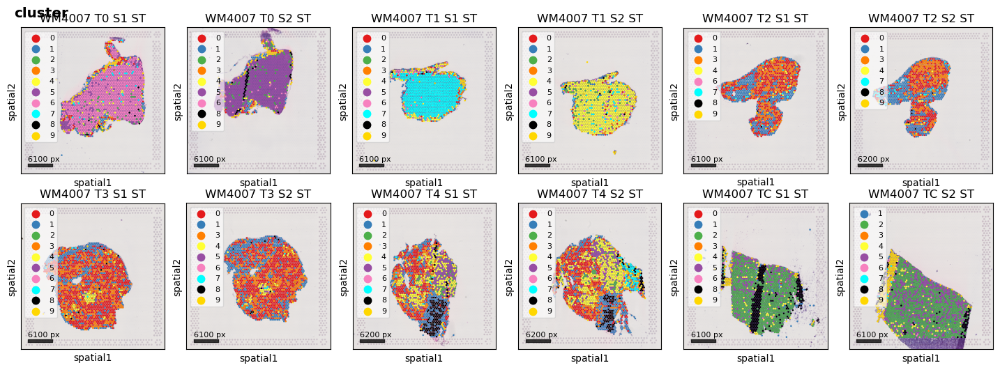

In [21]:
plotSpatialAll(ads, identity='cluster_harmonized', nx=ncols, maintainScale=False, palette=palette_rna, f=0.6)
plotSpatialAll(ads, identity='cluster', nx=ncols, maintainScale=False, palette=palette_rna, f=0.6)

In [22]:
ad_im_all.write(dataPath + 'ad_all_human_clustered_im_st_%s.h5ad' % model)

# Both: Load ST and AD processed objects

In [5]:
ad_im_all = sc.read(dataPath + 'ad_all_human_clustered_im_st_%s.h5ad' % model)

In [6]:
ad_im_ad_all = sc.read(dataPath + 'ad_all_human_clustered_im_ad_%s_m.h5ad' % model)

In [7]:
import matplotlib
matplotlib.rcParams['figure.dpi'] = 300

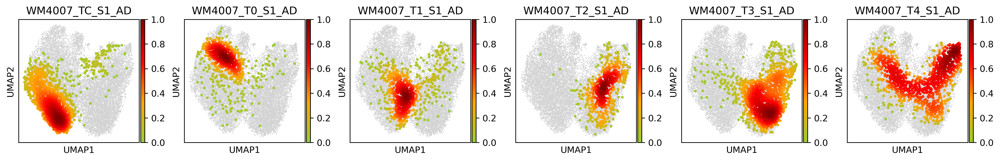

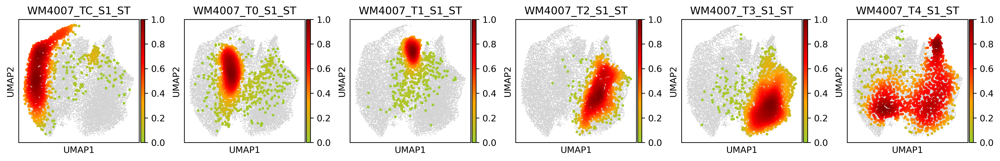

In [28]:
plt.rcParams["figure.figsize"] = (2.5, 2.5)
identity = 'sample'

sc.pl.embedding_density(ad_im_ad_all, groupby=identity, ncols=6, bg_dotsize=5, fg_dotsize=35, wspace=0.25,
                        color_map=matplotlib.colors.LinearSegmentedColormap.from_list('GR', ['yellowgreen', 'orange', 'red', 'maroon'], N=1000),
                        group=[f'{model}_TC_S1_AD', f'{model}_T0_S1_AD', f'{model}_T1_S1_AD', f'{model}_T2_S1_AD', f'{model}_T3_S1_AD', f'{model}_T4_S1_AD'], save='A1_%s.png' % model)

sc.pl.embedding_density(ad_im_all, groupby=identity, ncols=6, bg_dotsize=5, fg_dotsize=35, wspace=0.25,
                        color_map=matplotlib.colors.LinearSegmentedColormap.from_list('GR', ['yellowgreen', 'orange', 'red', 'maroon'], N=1000),
                        group=[f'{model}_TC_S1_ST', f'{model}_T0_S1_ST', f'{model}_T1_S1_ST', f'{model}_T2_S1_ST', f'{model}_T3_S1_ST', f'{model}_T4_S1_ST'], save='A2_%s.png' % model)

In [9]:
from sklearn.cluster import SpectralCoclustering
def reorder(df, n_co_clusters=4):
    model = SpectralCoclustering(n_clusters=n_co_clusters, random_state=0)
    model.fit(df.values)
    rows_order, cols_order = np.argsort(model.row_labels_), np.argsort(model.column_labels_)
    df = pd.DataFrame(data=df.values[rows_order][:, cols_order], index=df.index[rows_order], columns=df.columns[cols_order])
    return df

In [10]:
ad_all = sc.read(dataPath + 'ad_all_human_clustered_st_%s.h5ad' % model)
ad_all = ad_all[ad_all.obs['human_ratio']>=0.25]
ad_all.shape

(10843, 17788)

In [11]:
ad_im_all = ad_im_all[ad_all.obs.index.intersection(ad_im_all.obs.index), :]
ad_im_all.obs['rna_cluster'] = ad_all.obs['cluster'].reindex(ad_im_all.obs.index).values
ad_im_all.shape

(10836, 2048)

In [72]:
import pickle
from sklearn.svm import SVC
from sklearn.metrics import roc_auc_score
from sklearn.model_selection import cross_val_score

# Features selected by JR
resist_v_sensLineages_DiffImagingFeatures = pd.read_csv('resist_v_sensLineages_DiffImagingFeatures.txt', sep=' ').index
resist_v_sensLineages_DiffImagingFeatures.shape

# RNA cluster 4 vs 8
df = ad_im_all[ad_im_all.obs['rna_cluster'].isin(['4', '8'])].to_df()[resist_v_sensLineages_DiffImagingFeatures]
se = (ad_im_all.obs['rna_cluster'][ad_im_all.obs['rna_cluster'].isin(['4', '8'])]=='8').astype(int)
df.shape, se.shape

np.random.seed(1)
se0 = se[se==0]
se1 = se[se==1]

ind_train = pd.concat([se0.sample(int(se0.shape[0]*0.8)), se1.sample(int(se1.shape[0]*0.8))]).index
ind_test = se.index.difference(ind_train)

X_train = df.loc[ind_train].values
y_train = se.loc[ind_train].values
print(X_train.shape, y_train.shape)

X_test = df.loc[ind_test].values
y_test = se.loc[ind_test].values
print(X_test.shape, y_test.shape)

clf = SVC(C=0.01, kernel='linear', class_weight='balanced', tol=0.0000001, probability=True)
scores = cross_val_score(clf, X_train, y_train, cv=5, scoring='roc_auc')
print('Train cross-validation AUC:', np.round(np.mean(scores), 3), '+-', np.round(np.std(scores), 3), scores)

clf.fit(X_train, y_train)
print('Test AUC:', np.round(roc_auc_score(y_test, clf.predict(X_test)), 3))

with open('clf_WM4007_77feat_1_prolif.pklz', 'wb') as tempfile:
    pickle.dump((clf, resist_v_sensLineages_DiffImagingFeatures), tempfile)

Train cross-validation AUC: 0.82 +- 0.032 [0.81275222 0.85514941 0.79497652 0.85719148 0.77775509]
Test AUC: 0.79


In [14]:
sc.pp.neighbors(ad_im_all, use_rep='X_pca')
sc.tl.leiden(ad_im_all, key_added='cluster_coarse', resolution=0.35)

In [15]:
intersection_spots = ad_all.obs.index.intersection(ad_im_all.obs.index)
df = pd.crosstab(ad_all.obs['cluster'][intersection_spots].rename('ST RNA'),
                 ad_im_all.obs['cluster_coarse'][intersection_spots].rename('ST H&E'))
reorder(df, n_co_clusters=3).T.style.background_gradient(axis=None)
# df.style.background_gradient(axis=None)

ST RNA,0,1,5,6,9,4,7,2,3,8
ST H&E,,,,,,,,,,
2,788,1515,659,329,45,16,0,187,252,114
3,280,324,173,79,11,5,0,22,46,6
4,90,14,9,70,39,49,0,16,26,5
0,227,9,10,7,48,749,54,142,151,160
1,328,712,313,52,39,288,0,1332,811,235


In [17]:
ad_im_all.obs['cluster_coarse'].to_csv(f'{model}_im_st_cluster_coarse.csv')

In [15]:
intersection_spots = ad_all.obs.index.intersection(ad_im_all.obs.index)
df = pd.crosstab(ad_all.obs['cluster'][intersection_spots].rename('ST RNA'),
                 ad_im_all.obs['cluster_coarse'][intersection_spots].rename('ST H&E'))
reorder(df, n_co_clusters=3).T.style.background_gradient(axis=None)

ST RNA,0,1,5,6,9,4,7,2,3,8
ST H&E,,,,,,,,,,
2,788,1515,659,329,45,16,0,187,252,114
3,280,324,173,79,11,5,0,22,46,6
4,90,14,9,70,39,49,0,16,26,5
0,227,9,10,7,48,749,54,142,151,160
1,328,712,313,52,39,288,0,1332,811,235


In [16]:
sc.pp.neighbors(ad_im_all, use_rep='X_pca_harmony')
sc.tl.leiden(ad_im_all, key_added='cluster_coarse_harmonized', resolution=0.35)

In [17]:
intersection_spots = ad_all.obs.index.intersection(ad_im_all.obs.index)
df = pd.crosstab(ad_all.obs['cluster'][intersection_spots].rename('ST RNA'),
                 ad_im_all.obs['cluster_coarse_harmonized'][intersection_spots].rename('ST H&E'))
reorder(df, n_co_clusters=3).T.style.background_gradient(axis=None)

ST RNA,1,2,3,5,8,0,6,9,4,7
ST H&E,,,,,,,,,,
1,1755,542,706,729,262,893,327,52,183,0
2,752,878,414,366,115,387,125,31,208,0
3,40,93,58,44,25,278,76,72,207,16
0,27,186,108,25,118,155,9,27,509,38


In [21]:
intersection_spots = ad_all.obs.index.intersection(ad_im_all.obs.index)
df = pd.crosstab(ad_all.obs['cluster'][intersection_spots].rename('ST RNA'),
                 ad_im_all.obs['cluster_coarse_harmonized'][intersection_spots].rename('ST H&E'))
reorder(df, n_co_clusters=3).T.style.background_gradient(axis=None)

ST RNA,1,2,3,5,8,0,6,9,4,7
ST H&E,,,,,,,,,,
1,1755,542,706,729,262,893,327,52,183,0
2,752,878,414,366,115,387,125,31,208,0
3,40,93,58,44,25,278,76,72,207,16
0,27,186,108,25,118,155,9,27,509,38


In [22]:
intersection_spots = ad_all.obs.index.intersection(ad_im_all.obs.index)
df = pd.crosstab(ad_all.obs['cluster'][intersection_spots].rename('ST RNA'),
                 ad_im_all.obs['cluster_coarse_harmonized'][intersection_spots].rename('ST H&E'))

makeSankeyDiagram(df, border=25, colormapForIndex=palette_rna, colormapForColumns=None)

Using default columns nodes colors
rgba(128,128,128,1.0)
Cannot save static image (likely due to missing orca). Saving to interactive html


In [16]:
intersection_spots = ad_cnv.obs.index.intersection(ad_im_all.obs.index)
df = pd.crosstab(ad_cnv.obs['cnv_clusters'][intersection_spots].rename('ST CNV'),
                 ad_im_all.obs['cluster_coarse'][intersection_spots].rename('ST H&E'))
reorder(df, n_co_clusters=3).T.style.background_gradient(axis=None)

ST CNV,0,1,3,5,6,9,4,7,8,10,2
ST H&E,,,,,,,,,,,
1,792,639,421,300,524,124,538,238,147,0,388
2,887,461,653,694,339,44,50,109,104,0,563
0,99,368,83,28,271,39,616,478,366,58,243
3,217,70,187,191,19,28,19,7,13,0,197
4,25,20,52,3,5,20,52,9,0,0,130


In [17]:
intersection_spots = ad_cnv.obs.index.intersection(ad_im_all.obs.index)
df = pd.crosstab(ad_cnv.obs['cnv_clusters'][intersection_spots].rename('ST CNV'),
                 ad_im_all.obs['cluster_coarse'][intersection_spots].rename('ST H&E'))
makeSankeyDiagram(df, border=25, colormapForIndex=palette_rna, colormapForColumns=None)

Using default columns nodes colors
rgba(128,128,128,1.0)
Cannot save static image (likely due to missing orca). Saving to interactive html


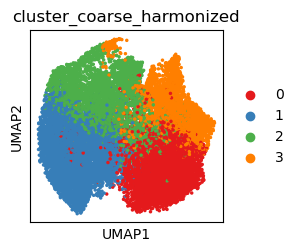

In [23]:
sc.pl.umap(ad_im_all, color=['cluster_coarse_harmonized'], palette=palette_rna, s=25)

In [28]:
images = {id: [(ad_temp := sc.read(preprocessedStDataPath + '%s/st_adata_processed.h5ad' % id)).uns['spatial'], ad_temp.obs.index, ad_temp.obsm['spatial']] for id in ids}

ad_im_all.obs['count_connective'] = ad_im_all.obs['count_connective'].fillna(0).astype(int)
ad_im_all.obs['count_neoplasia'] = ad_im_all.obs['count_neoplasia'].fillna(0).astype(int)

ads = dict()
for sample in ids[:]:
    ads[sample] = ad_im_all[ad_im_all.obs['sample']==sample, :].copy()    
    ads[sample].uns['spatial'] = images[sample][0]
    ads[sample].obsm['spatial'] = pd.DataFrame(index=images[sample][1], data=images[sample][2]).reindex(ads[sample].obs['original_barcode']).values

In [29]:
intersection_spots = ad_all.obs.index.intersection(ad_im_all.obs.index)
for sample in ids[:]:
    ads[sample] = ads[sample][ads[sample].obs.index.isin(intersection_spots)]

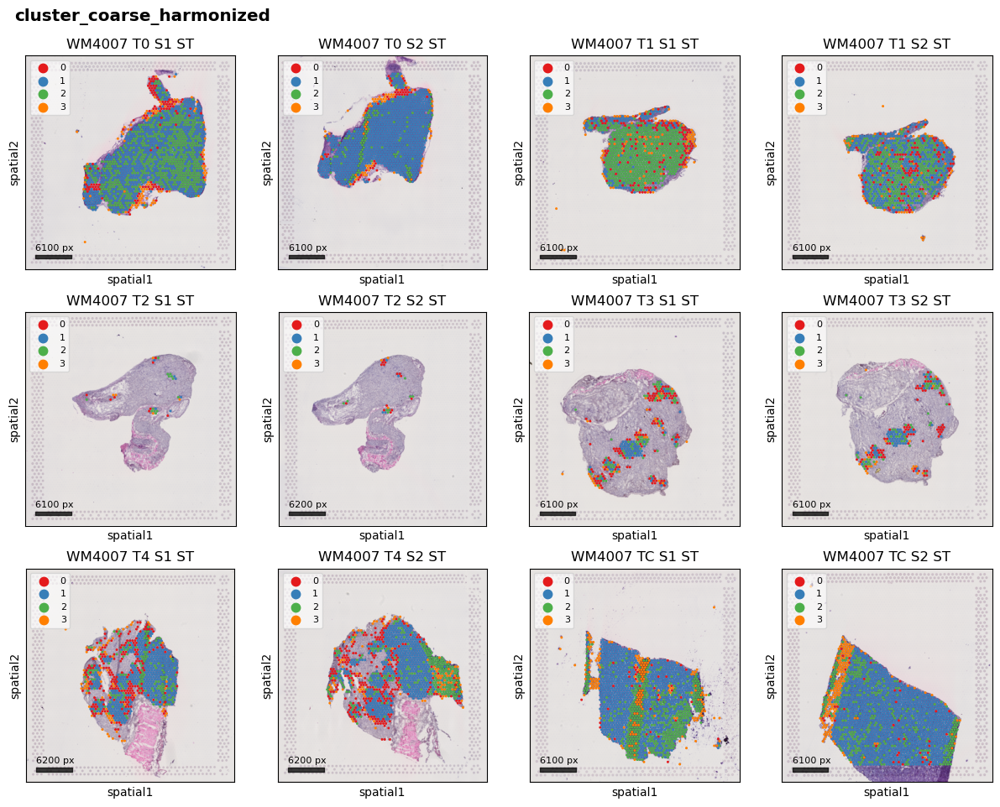

In [30]:
plotSpatialAll(ads, identity='cluster_coarse_harmonized', palette=palette_rna)

In [29]:
pd.crosstab(ad_cnv.obs['cnv_clusters'].rename('ST CNV Custer'),
            ad_cnv.obs['time'].rename('ST T'))

ST T,T0,T1,T2,T3,T4,TC
ST CNV Custer,,,,,,
0,918,285,10,59,4,744
1,61,609,31,296,38,523
2,548,224,3,11,16,724
3,796,64,2,3,0,533
4,1,649,49,378,163,35
5,333,89,4,13,4,773
6,0,14,11,167,955,11
7,0,2,4,41,794,0
8,128,50,118,251,3,80


In [73]:
se_score = pd.read_csv(f'c:/Projects/A_ST/github-pipelines/PDX-melanoma-integrated-analysis/modules/WM4007/score_HOEK_INVASIVE_{model}.csv', index_col=0)['score_HOEK_INVASIVE']
se_score

AAACAAGTATCTCCCA-1-WM4007_T0_S1_ST    0.344867
AAACAGAGCGACTCCT-1-WM4007_T0_S1_ST    0.565119
AAACCCGAACGAAATC-1-WM4007_T0_S1_ST    0.413668
AAACCGTTCGTCCAGG-1-WM4007_T0_S1_ST    0.423527
AAACGAGACGGTTGAT-1-WM4007_T0_S1_ST    0.415316
                                        ...   
TTGTGTTTCCCGAAAG-1-WM4007_T4_S2_ST    0.765858
TTGTTAGCAAATTCGA-1-WM4007_T4_S2_ST    0.665034
TTGTTCAGTGTGCTAC-1-WM4007_T4_S2_ST    0.739038
TTGTTGTGTGTCAAGA-1-WM4007_T4_S2_ST    0.806827
TTGTTTCACATCCAGG-1-WM4007_T4_S2_ST    0.636149
Name: score_HOEK_INVASIVE, Length: 10843, dtype: float64

In [74]:
ad_im_all.obs['score_HOEK_INVASIVE'] = se_score.reindex(ad_im_all.obs.index).values

In [75]:
cond = ~ad_im_all.obs['score_HOEK_INVASIVE'].isna()
se_feat_corr = pd.Series(1 - scipy.spatial.distance.cdist(ad_im_all[cond].to_df().values.T, ad_im_all.obs[cond][['score_HOEK_INVASIVE']].values.T, metric='correlation').T[0],
                         index=ad_im_all.var.index).sort_values(ascending=False)

In [90]:
ses = []
for id in ids:
    cond = ~ads[id].obs['score_HOEK_INVASIVE'].isna()
    se_feat_corr = pd.Series(1 - scipy.spatial.distance.cdist(ads[id][cond].to_df().values.T, ads[id].obs[cond][['score_HOEK_INVASIVE']].values.T, metric='correlation').T[0],
                             index=ads[id].var.index).sort_values(ascending=False)
    ses.append(se_feat_corr)
se_feat_corr = pd.concat(ses, axis=1).mean(axis=1)

In [93]:
c = 0.22
sel_feat = se_feat_corr[se_feat_corr.abs()>=c].index
se_feat_corr[se_feat_corr.abs()>=c].sort_values(ascending=False)

feat104     0.247766
feat1429    0.247075
feat1748    0.234457
feat1795    0.228622
feat317     0.228167
feat1929    0.226734
feat2011    0.226393
feat36      0.226075
feat1435    0.222210
feat2035   -0.220427
feat253    -0.223635
feat161    -0.249541
dtype: float64

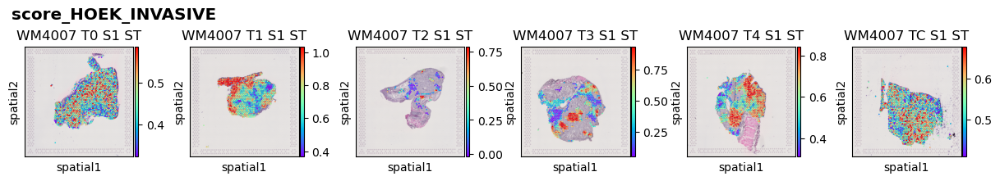

In [95]:
plotSpatialAll({id:ads[id] for id in ids if ('_S1_' in id)}, identity='score_HOEK_INVASIVE', nx=6, fy=0.7, maintainScale=True, palette=palette_rna, f=0.5, y=1.15, wspace=0.3, uniformColorScale=False)

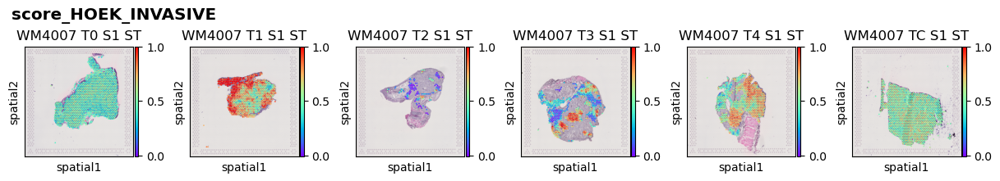

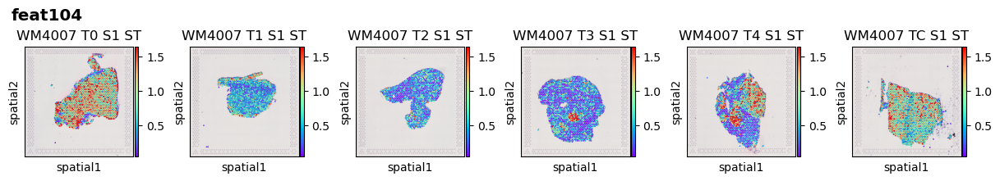

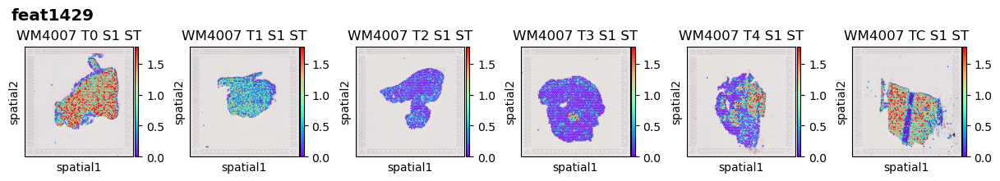

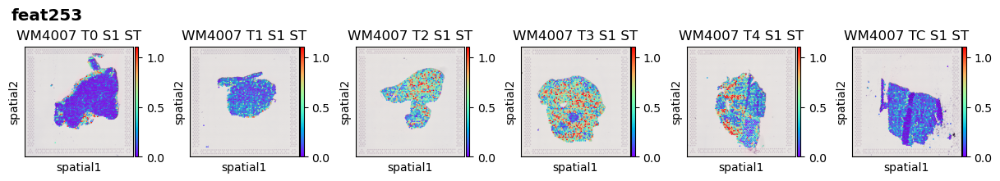

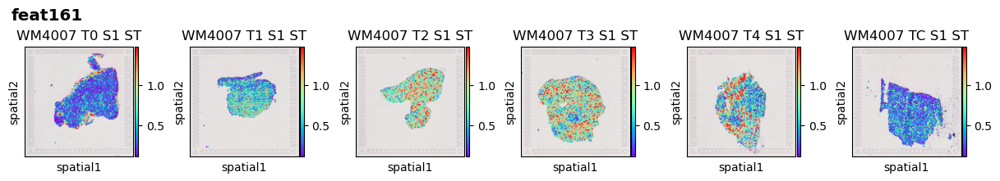

In [94]:
plotSpatialAll({id:ads[id] for id in ids if ('_S1_' in id)}, identity='score_HOEK_INVASIVE', nx=6, fy=0.7, maintainScale=True, palette=palette_rna, f=0.5, y=1.15, wspace=0.3)

plotSpatialAll({id:ads[id] for id in ids if ('_S1_' in id)}, identity='feat104', nx=6, fy=0.7, maintainScale=True, palette=palette_rna, f=0.5, y=1.15, wspace=0.3)
plotSpatialAll({id:ads[id] for id in ids if ('_S1_' in id)}, identity='feat1429', nx=6, fy=0.7, maintainScale=True, palette=palette_rna, f=0.5, y=1.15, wspace=0.3)

plotSpatialAll({id:ads[id] for id in ids if ('_S1_' in id)}, identity='feat253', nx=6, fy=0.7, maintainScale=True, palette=palette_rna, f=0.5, y=1.15, wspace=0.3)
plotSpatialAll({id:ads[id] for id in ids if ('_S1_' in id)}, identity='feat161', nx=6, fy=0.7, maintainScale=True, palette=palette_rna, f=0.5, y=1.15, wspace=0.3)

In [13]:
ad_cnv = sc.read(dataPath + 'ad_all_human_clustered_cnv_%s.h5ad' % model)
ad_cnv.shape

(11935, 8625)

In [18]:
ad_im_all = sc.read(dataPath + 'ad_all_human_clustered_im_st_%s.h5ad' % model)
ad_im_all.shape

(18108, 2048)

In [24]:
ad_im_all.obs['cnv_cluster'] = ad_cnv.obs['cnv_clusters'].astype(str).reindex(ad_im_all.obs.index).fillna('NA')

In [25]:
identity = 'Sensitivity in Untreated'
ad_im_all.obs[identity] = 'other'

ad_im_all.obs.loc[ad_im_all.obs.index.intersection(ad_cnv.obs.index[ad_cnv.obs['cnv_clusters'].isin(['0', '3', '5']) & ad_cnv.obs['time'].isin(['T0', 'TC'])]), identity] = 'sensitive'
ad_im_all.obs.loc[ad_im_all.obs.index.intersection(ad_cnv.obs.index[ad_cnv.obs['cnv_clusters'].isin(['1', '4', '6', '7', '8', '9']) & ad_cnv.obs['time'].isin(['T0', 'TC'])]), identity] = 'resistant'

# ad_im_all.obs.loc[ad_im_all.obs.index.intersection(ad_cnv.obs.index[ad_cnv.obs['cnv_clusters'].isin(['7']) & ad_cnv.obs['time'].isin(['T4'])]), 'Sensitivity'] = 'resistant'
# ad_im_all.obs.loc[ad_im_all.obs.index.intersection(ad_cnv.obs.index[ad_cnv.obs['cnv_clusters'].isin(['6', '9']) & ad_cnv.obs['time'].isin(['T4'])]), 'Sensitivity'] = 'sensitive'

# ad_im_all.obs.loc[ad_im_all.obs.index.intersection(ad_cnv.obs.index[ad_cnv.obs['cnv_clusters'].isin(['0', '3', '5'])]), identity] = 'sensitive'
# ad_im_all.obs.loc[ad_im_all.obs.index.intersection(ad_cnv.obs.index[ad_cnv.obs['cnv_clusters'].isin(['1', '4', '6', '7', '8', '9'])]), identity] = 'resistant'

ad_im_all.obs[identity] = ad_im_all.obs[identity].astype('category')
print(ad_im_all.obs[identity].value_counts())

other        13174
sensitive     4095
resistant      839
Name: Sensitivity in Untreated, dtype: int64


In [26]:
identity = 'Sensitivity'
ad_im_all.obs[identity] = 'other'

# ad_im_all.obs.loc[ad_im_all.obs.index.intersection(ad_cnv.obs.index[ad_cnv.obs['cnv_clusters'].isin(['0', '3', '5']) & ad_cnv.obs['time'].isin(['T0', 'TC'])]), identity] = 'sensitive'
# ad_im_all.obs.loc[ad_im_all.obs.index.intersection(ad_cnv.obs.index[ad_cnv.obs['cnv_clusters'].isin(['1', '4', '6', '7', '8', '9']) & ad_cnv.obs['time'].isin(['T0', 'TC'])]), identity] = 'resistant'

# ad_im_all.obs.loc[ad_im_all.obs.index.intersection(ad_cnv.obs.index[ad_cnv.obs['cnv_clusters'].isin(['7']) & ad_cnv.obs['time'].isin(['T4'])]), 'Sensitivity'] = 'resistant'
# ad_im_all.obs.loc[ad_im_all.obs.index.intersection(ad_cnv.obs.index[ad_cnv.obs['cnv_clusters'].isin(['6', '9']) & ad_cnv.obs['time'].isin(['T4'])]), 'Sensitivity'] = 'sensitive'

ad_im_all.obs.loc[ad_im_all.obs.index.intersection(ad_cnv.obs.index[ad_cnv.obs['cnv_clusters'].isin(['0', '3', '5'])]), identity] = 'sensitive'
ad_im_all.obs.loc[ad_im_all.obs.index.intersection(ad_cnv.obs.index[ad_cnv.obs['cnv_clusters'].isin(['1', '4', '6', '7', '8', '9'])]), identity] = 'resistant'

ad_im_all.obs[identity] = ad_im_all.obs[identity].astype('category')
print(ad_im_all.obs[identity].value_counts())

other        7759
resistant    5717
sensitive    4632
Name: Sensitivity, dtype: int64


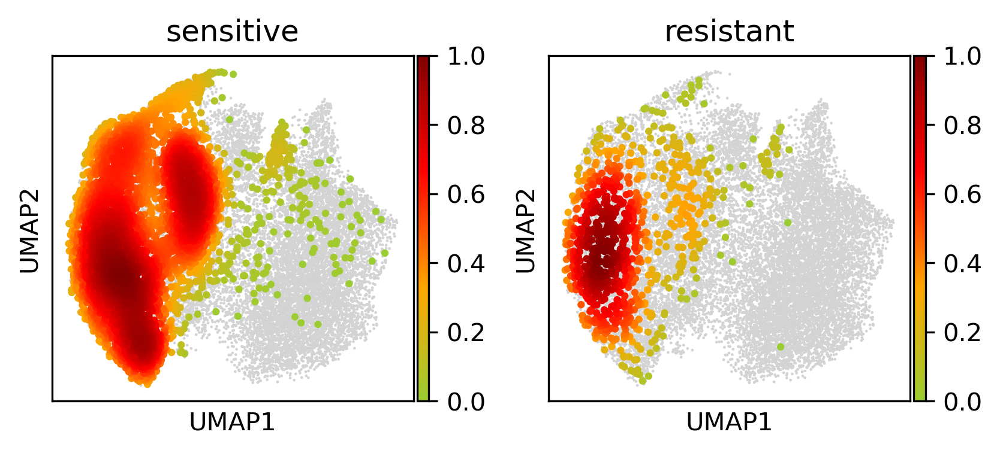

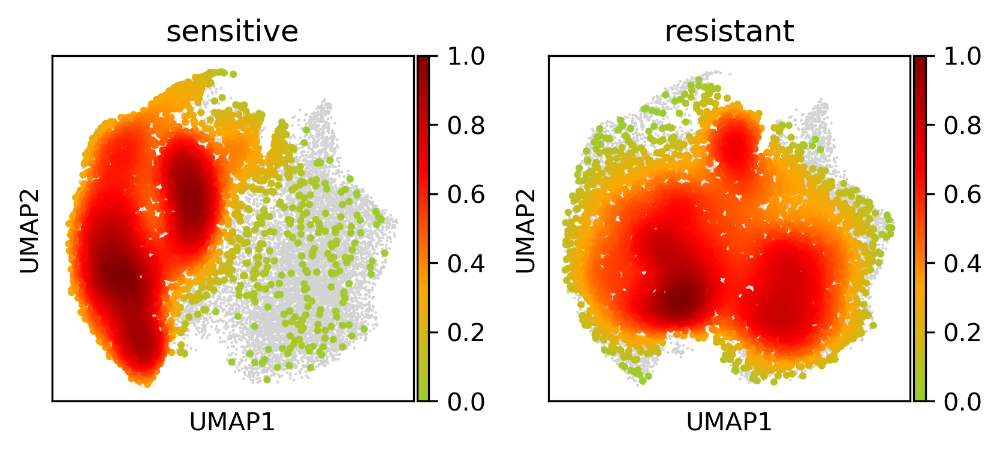

In [27]:
plt.rcParams["figure.figsize"] = (2.5, 2.5)

identity = 'Sensitivity in Untreated'
sc.tl.embedding_density(ad_im_all, basis='umap', groupby=identity)
sc.pl.embedding_density(ad_im_all, groupby=identity, ncols=6, bg_dotsize=5, fg_dotsize=35, wspace=0.25,
                        color_map=matplotlib.colors.LinearSegmentedColormap.from_list('GR', ['yellowgreen', 'orange', 'red', 'maroon'], N=1000),
                        group=['sensitive', 'resistant'])

identity = 'Sensitivity'
sc.tl.embedding_density(ad_im_all, basis='umap', groupby=identity)
sc.pl.embedding_density(ad_im_all, groupby=identity, ncols=6, bg_dotsize=5, fg_dotsize=35, wspace=0.25,
                        color_map=matplotlib.colors.LinearSegmentedColormap.from_list('GR', ['yellowgreen', 'orange', 'red', 'maroon'], N=1000),
                        group=['sensitive', 'resistant'])

In [30]:
sc.tl.rank_genes_groups(ad_im_all, 'Sensitivity', method='wilcoxon')

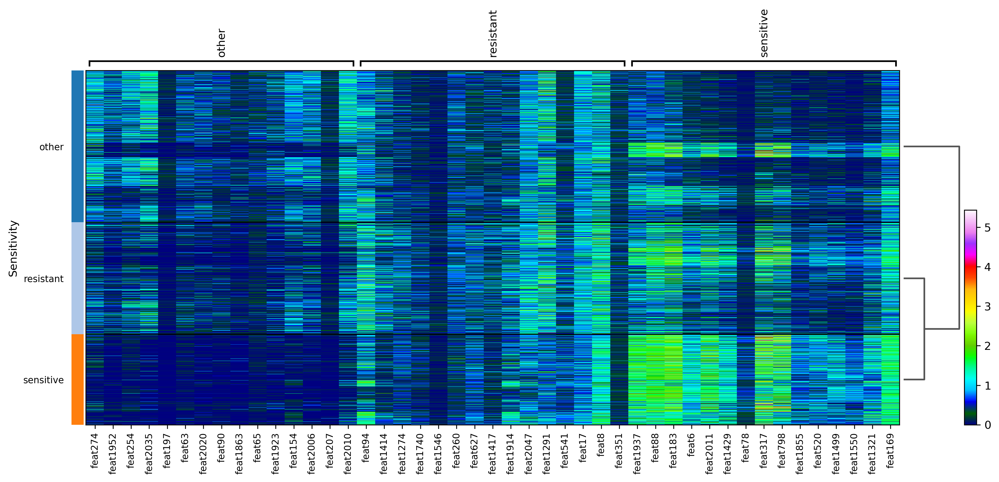

In [31]:
sc.pl.rank_genes_groups_heatmap(ad_im_all, n_genes=15, groupby=['Sensitivity'], show_gene_labels=True, cmap='gist_ncar')

In [29]:
images = {id: [(ad_temp := sc.read(preprocessedStDataPath + '%s/st_adata_processed.h5ad' % id)).uns['spatial'], ad_temp.obs.index, ad_temp.obsm['spatial']] for id in ids if not 'TE' in id}

ads_st = dict()
for sample in ids:
    try:
        ads_st[sample] = ad_im_all[ad_im_all.obs['sample']==sample, :].copy()    
        ads_st[sample].uns['spatial'] = images[sample][0]
        ads_st[sample].obsm['spatial'] = pd.DataFrame(index=images[sample][1], data=images[sample][2]).reindex(ads_st[sample].obs['original_barcode']).values
    except:
        pass

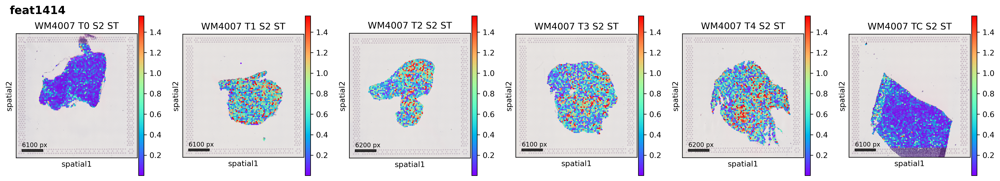

In [38]:
plotSpatialAll(ads_st, ids=[id for id in ids if not 'TE' in id and 'S2' in id], identity='feat1414', nx=ncols, wspace=0.25, dpi=600, maintainScale=False, saveName=f'{model}_high_in_resistant')

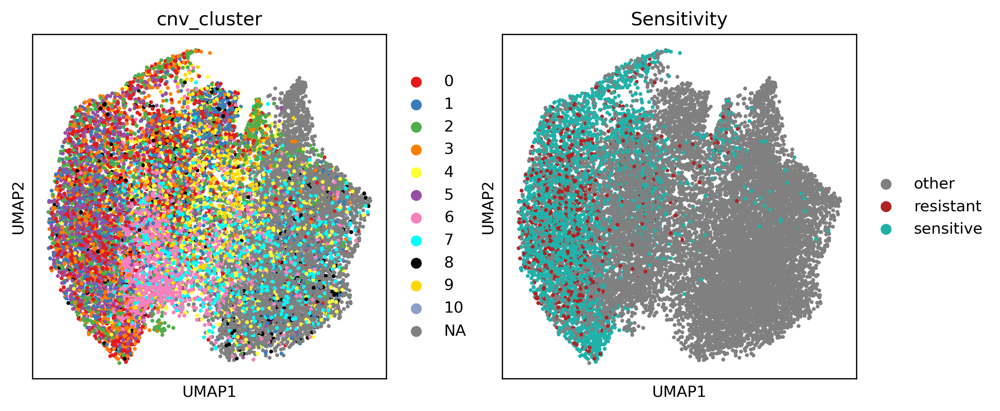

In [20]:
plt.rcParams["figure.figsize"] = (4, 4)
palette_rna.update({'sensitive': 'lightseagreen', 'resistant': 'firebrick', 'other': 'grey', 'NA': 'grey'})
sc.pl.umap(ad_im_all, color=['cnv_cluster', 'Sensitivity'], palette=palette_rna, s=25)

In [430]:
se_feat_corr = pd.Series(1 - scipy.spatial.distance.cdist(ad_im_all[ad_im_all.obs.index[ad_im_all.obs['Sensitivity'].isin(['resistant', 'sensitive'])], :].to_df().values.T,
                                 ad_im_all.obs[['Sensitivity']][ad_im_all.obs['Sensitivity'].isin(['resistant', 'sensitive'])].isin(['resistant']).values.T, metric='correlation').T[0],
          index=ad_im_all.var.index).sort_values(ascending=False)

In [432]:
c = 0.075
sel_feat = se_feat_corr[se_feat_corr.abs()>=c].index
se_feat_corr[se_feat_corr.abs()>=c]

feat941     0.173079
feat795     0.169830
feat321     0.157424
feat874     0.157337
feat300     0.146761
              ...   
feat275    -0.101608
feat1781   -0.103994
feat1251   -0.108954
feat1903   -0.110896
feat265    -0.112313
Length: 250, dtype: float64

In [433]:
ad_im_all = ad_im_all[ad_im_all.obs.index[ad_im_all.obs['Sensitivity'].isin(['resistant', 'sensitive'])], :]
ad_im_all.shape

(4934, 2048)

In [434]:
from sklearn.svm import SVC
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import f1_score

In [439]:
df_train = ad_im_all.to_df()[sel_feat].sample(3000)
X_train, y_train = df_train.values, ad_im_all.obs['Sensitivity'][df_train.index].isin(['resistant']).astype(int).values
print(y_train.shape)

clf = make_pipeline(StandardScaler(), SVC(gamma='auto'))
clf.fit(X_train, y_train);

pred = clf.predict(X_train)
print('F1 score:\t', np.round(f1_score(pred, y_train), 3))
# print('PPV:\t\t', np.round((pred[y_train==1]==1).sum() / (pred==1).sum(), 3))
# print('NPV:\t\t', np.round((pred[y_train==0]==0).sum() / (pred==0).sum(), 3))

(3000,)
F1 score:	 0.117


In [440]:
df_test = ad_im_all.to_df()[sel_feat].loc[ad_im_all.obs.index.difference(df_train.index)]
X_test, y_test = df_test.values, ad_im_all.obs['Sensitivity'][df_test.index].isin(['resistant']).astype(int).values
print(y_test.shape)

pred_test = clf.predict(X_test)
print('F1 score:\t', np.round(f1_score(pred_test, y_test), 3))
# print('PPV:\t\t', np.round((pred_test[y_test==1]==1).sum() / (pred_test==1).sum(), 3))
# print('NPV:\t\t', np.round((pred_test[y_test==0]==0).sum() / (pred_test==0).sum(), 3))

(1934,)
F1 score:	 0.0


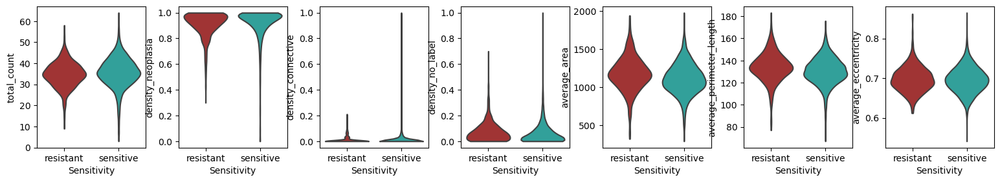

In [342]:
plt.rcParams["figure.figsize"] = (3,3)
sc.pl.violin(ad_im_all, keys=['total_count', 'density_neoplasia', 'density_connective', 'density_no_label', 
                              'average_area', 'average_perimeter_length', 'average_eccentricity'], groupby='Sensitivity', stripplot=False)

In [62]:
images = {id: [(ad_temp := sc.read(preprocessedStDataPath + '%s/st_adata_processed.h5ad' % id)).uns['spatial'], ad_temp.obs.index, ad_temp.obsm['spatial']] for id in ids}

In [63]:
ad_im_all.obs['count_connective'] = ad_im_all.obs['count_connective'].fillna(0).astype(int)
ad_im_all.obs['count_neoplasia'] = ad_im_all.obs['count_neoplasia'].fillna(0).astype(int)

ads = dict()
for sample in ids[:]:
    ads[sample] = ad_im_all[ad_im_all.obs['sample']==sample, :].copy()    
    ads[sample].uns['spatial'] = images[sample][0]
    ads[sample].obsm['spatial'] = pd.DataFrame(index=images[sample][1], data=images[sample][2]).reindex(ads[sample].obs['original_barcode']).values

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


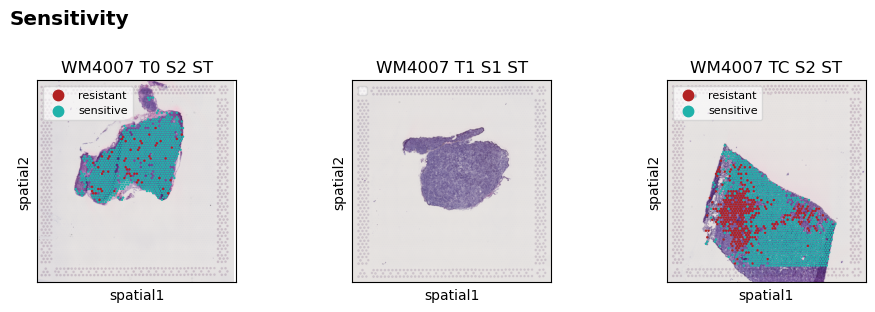

In [344]:
plotSpatialAll({id:ads[id] for id in ids if ('_T0_S2_' in id) or ('_T1_S1_' in id) or ('_TC_S2_' in id)}, identity='Sensitivity', nx=3, fy=0.7, maintainScale=True, palette=palette_rna, f=0.75, y=1.15, wspace=0.3)

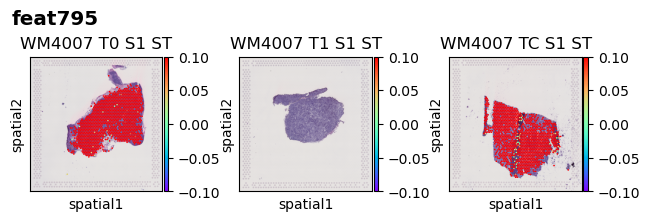

In [351]:
plotSpatialAll({id:ads[id] for id in ids if ('_T0_S1_' in id) or ('_T1_S1_' in id) or ('_TC_S1_' in id)}, identity='feat795', nx=3, fy=0.7, maintainScale=True, palette=palette_rna, f=0.5, y=1.15, wspace=0.3)

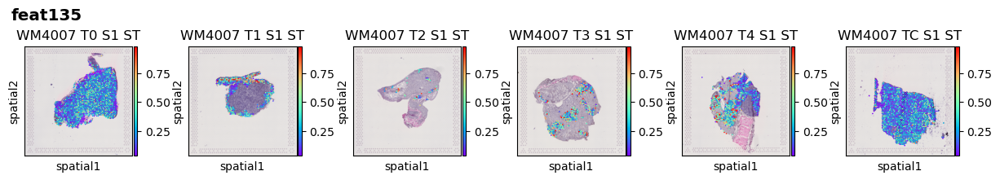

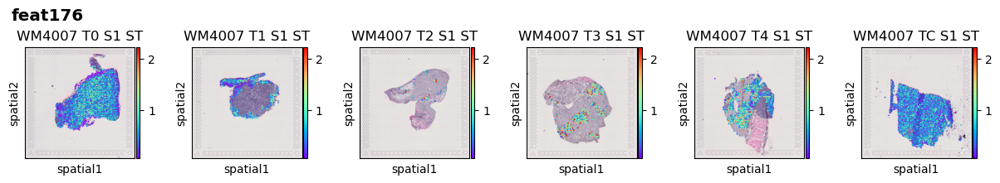

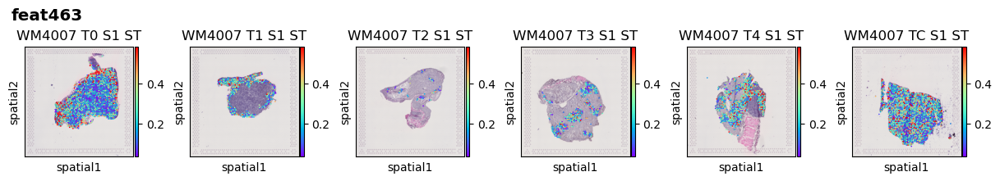

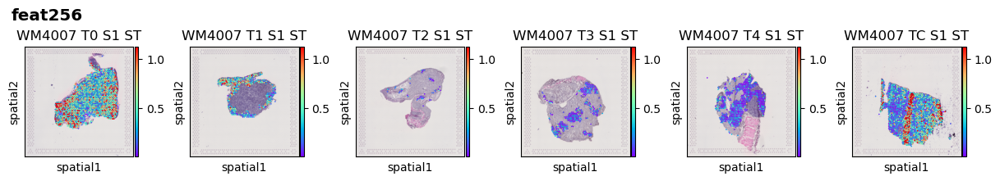

In [157]:
plotSpatialAll({id:ads[id] for id in ids if '_S1_' in id}, identity='feat135', nx=6, fy=0.7, maintainScale=True, palette=palette_rna, f=0.5, y=1.15, wspace=0.3)
plotSpatialAll({id:ads[id] for id in ids if '_S1_' in id}, identity='feat176', nx=6, fy=0.7, maintainScale=True, palette=palette_rna, f=0.5, y=1.15, wspace=0.3)
# plotSpatialAll({id:ads[id] for id in ids if '_S1_' in id}, identity='feat31', nx=6, fy=0.7, maintainScale=True, palette=palette_rna, f=0.5, y=1.15, wspace=0.3)
# plotSpatialAll({id:ads[id] for id in ids if '_S1_' in id}, identity='feat151', nx=6, fy=0.7, maintainScale=True, palette=palette_rna, f=0.5, y=1.15, wspace=0.3)
plotSpatialAll({id:ads[id] for id in ids if '_S1_' in id}, identity='feat463', nx=6, fy=0.7, maintainScale=True, palette=palette_rna, f=0.5, y=1.15, wspace=0.3)
plotSpatialAll({id:ads[id] for id in ids if '_S1_' in id}, identity='feat256', nx=6, fy=0.7, maintainScale=True, palette=palette_rna, f=0.5, y=1.15, wspace=0.3)

In [6]:
ad_all = sc.concat([ad_im_ad_all, ad_im_all], join='outer')
ad_all.obs['T'] = ad_all.obs['sample'].str.split('_', expand=True)[1]
ad_all.obs['Origin'] = ad_all.obs['sample'].str.split('_', expand=True)[3]
ad_all.shape

(34587, 2048)

In [39]:
sc.pp.highly_variable_genes(ad_all, flavor='seurat', batch_key='sample', n_top_genes=250)
sc.pp.pca(ad_all, n_comps=30, zero_center=True, use_highly_variable=True)

In [40]:
sce.pp.harmony_integrate(ad_all, 'Origin', lamb=1.0)

2023-06-07 10:54:44,409 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2023-06-07 10:54:49,658 - harmonypy - INFO - sklearn.KMeans initialization complete.
2023-06-07 10:54:49,873 - harmonypy - INFO - Iteration 1 of 10
2023-06-07 10:55:06,629 - harmonypy - INFO - Iteration 2 of 10
2023-06-07 10:55:23,449 - harmonypy - INFO - Converged after 2 iterations


In [41]:
sc.pp.neighbors(ad_all, use_rep='X_pca_harmony')
sc.tl.umap(ad_all)

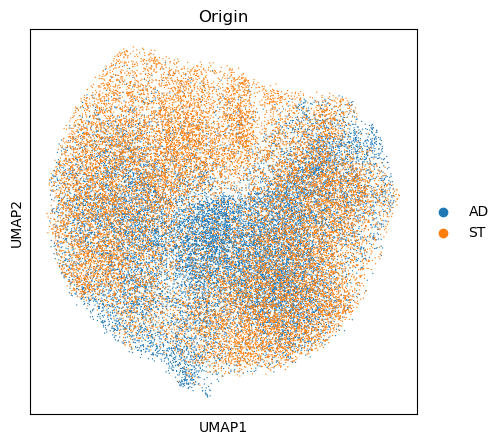

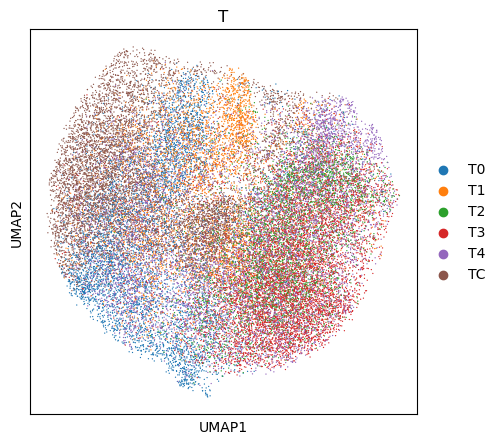

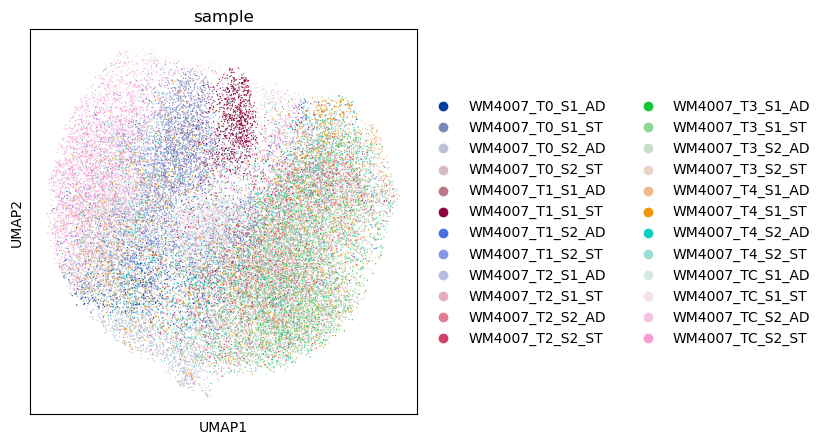

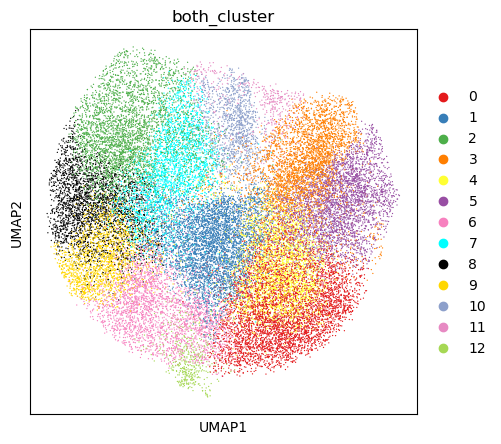

In [42]:
res_im = 1.0
sc.tl.leiden(ad_all, key_added='both_cluster', resolution=res_im)

plt.rcParams["figure.figsize"] = (5,5)
sc.pl.umap(ad_all, color=['Origin'])
sc.pl.umap(ad_all, color=['T'])
sc.pl.umap(ad_all, color=['sample'])
sc.pl.umap(ad_all, color=['both_cluster'], palette=palette_rna)

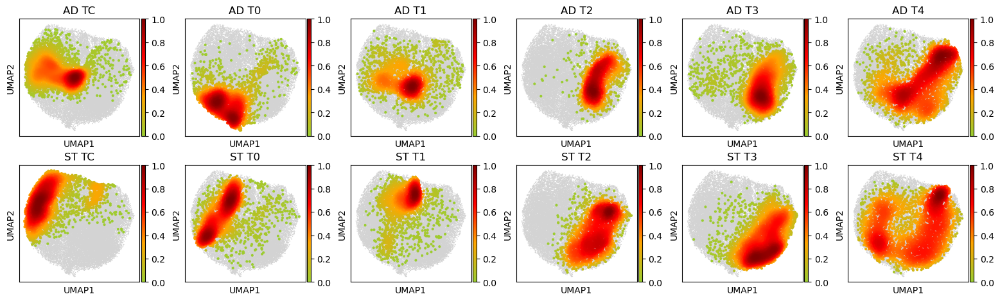

In [54]:
ad_all.obs['Origin and Time'] = ad_all.obs['sample'].str.split('_', expand=True)[3] + ' ' + ad_all.obs['sample'].str.split('_', expand=True)[1]
timepoints = ['TC', 'T0', 'T1', 'T2', 'T3', 'T4']
identity = 'Origin and Time'
sc.tl.embedding_density(ad_all, basis='umap', groupby=identity)
sc.pl.embedding_density(ad_all, groupby=identity, ncols=6, bg_dotsize=5, fg_dotsize=35, wspace=0.25,
                        color_map=matplotlib.colors.LinearSegmentedColormap.from_list('GR', ['yellowgreen', 'orange', 'red', 'maroon'], N=1000),
                       group=[f'AD {t}' for t in timepoints] + [f'ST {t}' for t in timepoints])

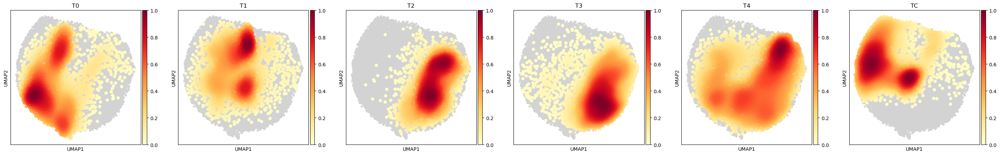

In [44]:
ad_all.obs['T'] = ad_all.obs['sample'].str.split('_', expand=True)[1]
sc.tl.embedding_density(ad_all, basis='umap', groupby='T')
sc.pl.embedding_density(ad_all, groupby='T', ncols=10)

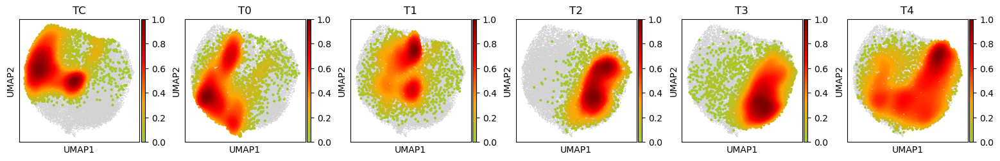

In [46]:
plt.rcParams["figure.figsize"] = (2.5, 2.5)
identity = 'T'
sc.pl.embedding_density(ad_all, groupby=identity, ncols=6, bg_dotsize=5, fg_dotsize=35, wspace=0.25,
                        color_map=matplotlib.colors.LinearSegmentedColormap.from_list('GR', ['yellowgreen', 'orange', 'red', 'maroon'], N=1000),
                        group=['TC', 'T0', 'T1', 'T2', 'T3', 'T4'])